In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
from IPython.display import display
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.io as pio
pio.templates.default = 'plotly_white'
import logging
import logzero
logzero.loglevel(logging.INFO)

In [2]:
# Functions frequently used
from BITS.util.io import load_pickle
from BITS.plot.plotly import make_hist, make_scatter, make_layout, show_plot

In [3]:
dir_fname = "work"
import os
os.chdir(dir_fname)

In [4]:
db_prefix = "DMEL_CSS"
db_fname = f"{db_prefix}.db"
las_fname = f"TAN.{db_prefix}.las"

In [5]:
from BITS.util.scheduler import Scheduler
scheduler = Scheduler("sge", "qsub", "all.q")

In [6]:
gepard_root = "/work2/yoshihiko_s/software/gepard"
gepard_jar = f"{gepard_root}/dist/Gepard-1.40.jar"
gepard_mat = f"{gepard_root}/resources/matrices/edna.mat"
gepard = f"java -cp {gepard_jar} org.gepard.client.cmdline.CommandLine -matrix {gepard_mat}"

from vca import ReadViewer
v = ReadViewer(db_fname, las_fname, gepard)

## Datander

In [6]:
from vca.datander import DatanderRunner

In [9]:
read_type = "CCS"
n_core = 8

In [10]:
r = DatanderRunner(db_prefix, read_type, n_core, scheduler)

In [11]:
r.run()

[I 190909 03:32:10 scheduler:28] Submitting a job: # Datander jobs (3)
    datander -k25 -w5 -h60 -e0.95 -s500 -T8 DMEL_CSS.1 DMEL_CSS.2 DMEL_CSS.3 DMEL_CSS.4
    datander -k25 -w5 -h60 -e0.95 -s500 -T8 DMEL_CSS.5 DMEL_CSS.6 DMEL_CSS.7 DMEL_CSS.8
    datander -k25 -w5 -h60 -e0.95 -s500 -T8 DMEL_CSS.9 DMEL_CSS.10 DMEL_CSS.11
    # Check all .las files jobs (3) (optional but recommended)
    LAcheck -vS DMEL_CSS TAN.DMEL_CSS.1 TAN.DMEL_CSS.2 TAN.DMEL_CSS.3 TAN.DMEL_CSS.4 TAN.DMEL_CSS.5
    LAcheck -vS DMEL_CSS TAN.DMEL_CSS.6 TAN.DMEL_CSS.7 TAN.DMEL_CSS.8 TAN.DMEL_CSS.9 TAN.DMEL_CSS.10
    LAcheck -vS DMEL_CSS TAN.DMEL_CSS.11
    # Merge jobs (11)
    LAmerge TAN.DMEL_CSS TAN.DMEL_CSS.1 TAN.DMEL_CSS.2 TAN.DMEL_CSS.3 TAN.DMEL_CSS.4 TAN.DMEL_CSS.5 TAN.DMEL_CSS.6 TAN.DMEL_CSS.7 TAN.DMEL_CSS.8 TAN.DMEL_CSS.9 TAN.DMEL_CSS.10 TAN.DMEL_CSS.11
    # Check merged .las file (optional but recommended)
    LAcheck -vS DMEL_CSS TAN.DMEL_CSS
    # TANmask jobs (3)
    TANmask DMEL_CSS TAN.DMEL_CSS.1 TA

## Look at some reads

In [23]:
!(LAshow {db_fname} {las_fname} | head -30)


TAN.DMEL_CSS: 253,959 records
       7         7 n   [ 1,268.. 6,111] x <     0.. 4,843]  ~   0.99%   (12,084 x 12,084 bps,    48 diffs, 11 trace pts)
       7         7 n   [ 2,530.. 6,112] x <     0.. 3,576]  ~   0.81%   (12,084 x 12,084 bps,    29 diffs,  8 trace pts)
       7         7 n   [ 3,799.. 6,111] x <     0.. 2,307]  ~   1.17%   (12,084 x 12,084 bps,    27 diffs,  6 trace pts)
       9         9 n   [ 7,754.. 8,265] x [   826.. 1,338]  ~   0.20%   (11,542 x 11,542 bps,     1 diffs,  2 trace pts)
      11        11 n   [     8..12,058] x [     3..12,053]  ~   0.66%   (12,159 x 12,159 bps,    80 diffs, 25 trace pts)
      11        11 n   [    72..12,058] x [     3..11,989]  ~   0.58%   (12,159 x 12,159 bps,    69 diffs, 25 trace pts)
      11        11 n   [   191..12,130] x [     3..11,945]  ~   0.64%   (12,159 x 12,159 bps,    77 diffs, 25 trace pts)
      11        11 n   [   306..12,130] x [     3..11,830]  ~   0.65%   (12,159 x 12,159 bps,    77 diffs, 25 trace pts)
 

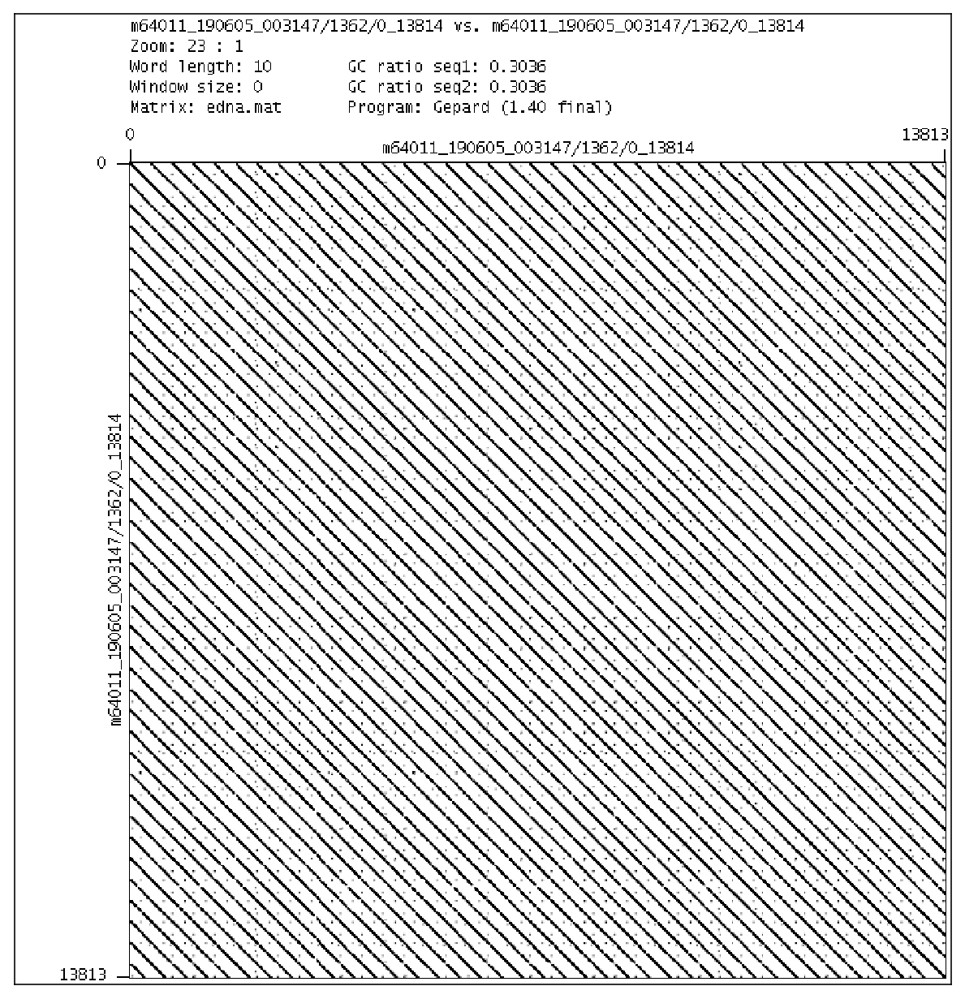

In [32]:
v.show(read_id=73, dot_plot=True)

## Datruf

In [33]:
from vca.datruf import DatrufRunner

In [34]:
n_core = 10
n_distribute = 20

In [35]:
r = DatrufRunner(db_fname, las_fname, n_core, n_distribute, scheduler)

In [36]:
r.run()

[I 190909 03:54:10 scheduler:28] Submitting a job: python -m vca.datruf.main DMEL_CSS.db TAN.DMEL_CSS.las datruf/tr_reads.pkl.01 1 22197 10
[I 190909 03:54:10 scheduler:28] Submitting a job: python -m vca.datruf.main DMEL_CSS.db TAN.DMEL_CSS.las datruf/tr_reads.pkl.02 22198 44394 10
[I 190909 03:54:10 scheduler:28] Submitting a job: python -m vca.datruf.main DMEL_CSS.db TAN.DMEL_CSS.las datruf/tr_reads.pkl.03 44395 66591 10
[I 190909 03:54:10 scheduler:28] Submitting a job: python -m vca.datruf.main DMEL_CSS.db TAN.DMEL_CSS.las datruf/tr_reads.pkl.04 66592 88788 10
[I 190909 03:54:10 scheduler:28] Submitting a job: python -m vca.datruf.main DMEL_CSS.db TAN.DMEL_CSS.las datruf/tr_reads.pkl.05 88789 110985 10
[I 190909 03:54:10 scheduler:28] Submitting a job: python -m vca.datruf.main DMEL_CSS.db TAN.DMEL_CSS.las datruf/tr_reads.pkl.06 110986 133182 10
[I 190909 03:54:10 scheduler:28] Submitting a job: python -m vca.datruf.main DMEL_CSS.db TAN.DMEL_CSS.las datruf/tr_reads.pkl.07 133183 1

## Extract centromeric TR reads

In [6]:
tr_reads_fname = "tr_reads.pkl"

In [7]:
from vca.filter_tr_reads import TRReadFilter

In [8]:
deviation = 0.015

In [9]:
f = TRReadFilter(tr_reads_fname, deviation=deviation)

In [10]:
f.hist_filtered_units()

[I 190911 20:44:48 filter_tr_reads:59] Peak unit lengths: 358 bp
[I 190911 20:44:48 filter_tr_reads:66] Peak intervals: 353.0-363.0 bp


In [21]:
f.run()

[I 190909 16:41:24 filter_tr_reads:59] Peak unit lengths: 358 bp
[I 190909 16:41:24 filter_tr_reads:66] Peak intervals: 353.0-363.0 bp
[I 190909 16:41:33 filter_tr_reads:41] 24814 TR reads -> 752 centromere reads


Only 752 reads!